## Prediksi Model AlexNet

In [1]:
import tensorflow as tf
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
modelAlex = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/Testing UAS/model_alexnet-1.h5')

In [3]:
modelAlex.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 55, 55, 96)        34944     
                                                                 
 max_pooling2d (MaxPooling2  (None, 27, 27, 96)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 27, 27, 64)        153664    
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 13, 13, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 13, 13, 128)       73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 13, 13, 128)       1

In [7]:
data = tf.keras.utils.image_dataset_from_directory('/content/drive/MyDrive/Colab Notebooks/Testing UAS/Dataset')
print(data.class_names)
class_names=data.class_names

Found 679 files belonging to 4 classes.
['Bolt', 'Carl', 'Olaf', 'Woody']


In [8]:
def predict_test(img_path, model):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)

    img = cv2.resize(img, (227, 227))
    img = img / 255.0

    test_img = np.expand_dims(img, axis=0)
    print(test_img.shape)

    predictions = []

    pred = model.predict(test_img)
    print(pred)
    print(np.argmax(pred))
    accuracy = pred[0][np.argmax(pred)] * 100

    predicted_class = class_names[np.argmax(pred)]

    plt.imshow(img)
    plt.axis('off')  # Turn off axis labels

    text = "Predicted Class: {}\nAccuracy : {:.2f}%".format(predicted_class, accuracy)
    plt.text(0.5, -0.15, text, ha='center', va='center', transform=plt.gca().transAxes, color='white', fontsize=10, bbox=dict(facecolor='black', alpha=0.7))

    predictions.append((predicted_class, accuracy))
    # Show the plot
    plt.show()

    return predictions



Carl9.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 39ms/step
[[2.1135653e-04 9.8030061e-01 3.5020593e-03 1.5985822e-02]]
1


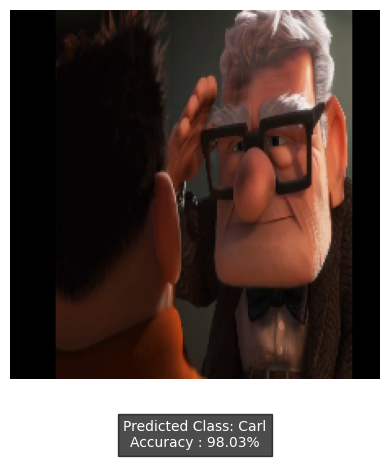

Carl6.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 35ms/step
[[2.4218903e-11 1.0000000e+00 3.4797128e-12 5.4650244e-14]]
1


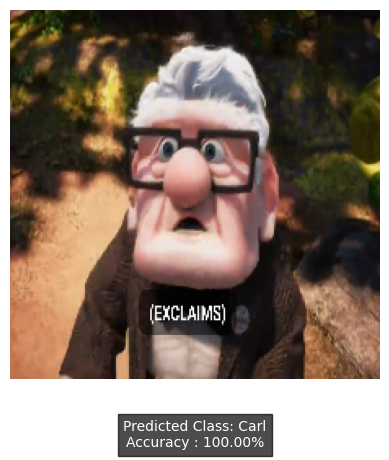

Carl8.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[0.00351563 0.8549298  0.1278831  0.01367147]]
1


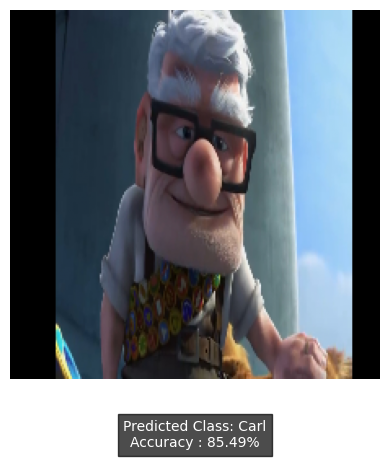

Carl7.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 34ms/step
[[8.0240426e-13 1.0000000e+00 3.4895978e-11 5.0873531e-13]]
1


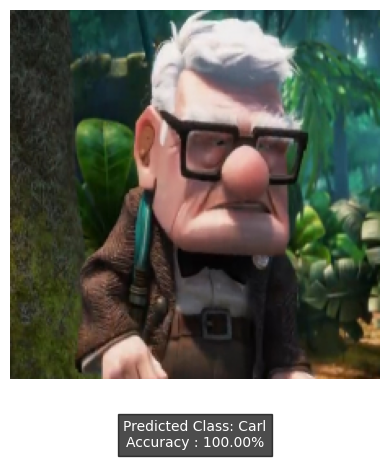

Carl2.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 34ms/step
[[1.2435667e-05 9.9302930e-01 6.9155768e-03 4.2732143e-05]]
1


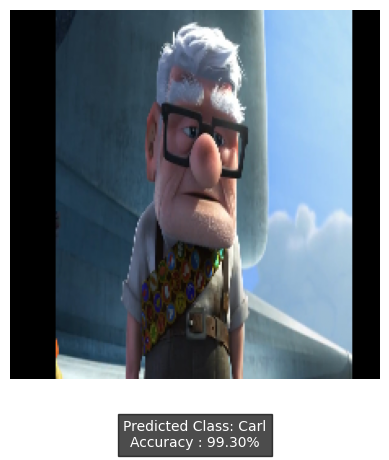

Carl3.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 35ms/step
[[9.477745e-09 1.000000e+00 4.921103e-11 9.298457e-12]]
1


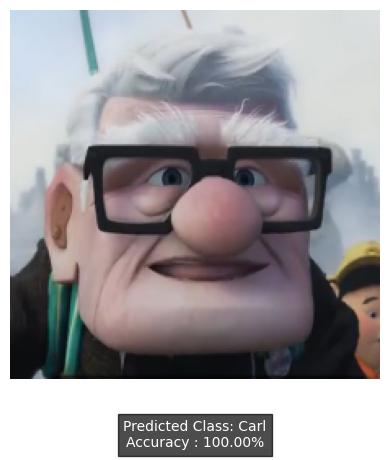

Carl4.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 36ms/step
[[0.14522214 0.5083394  0.22999911 0.11643942]]
1


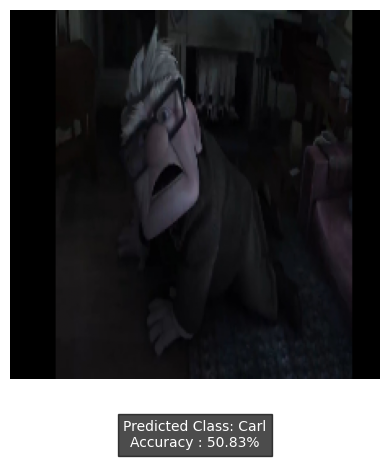

Carl5.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[2.4797948e-04 9.9809307e-01 1.6243928e-03 3.4613910e-05]]
1


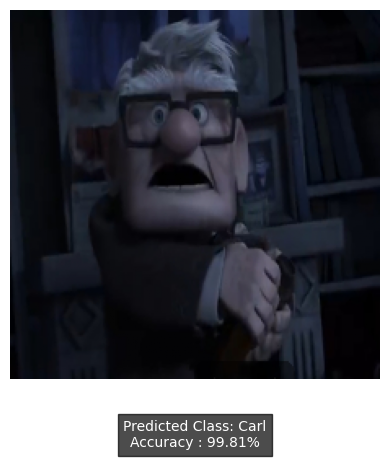

Carl10.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 34ms/step
[[6.5550096e-12 1.0000000e+00 7.9214102e-10 2.4091408e-12]]
1


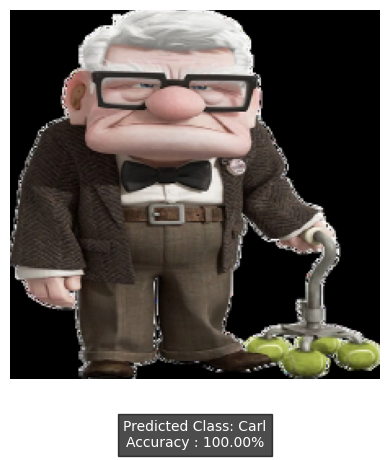

Carl1.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 36ms/step
[[7.6257834e-17 1.0000000e+00 5.1250575e-19 2.7830993e-19]]
1


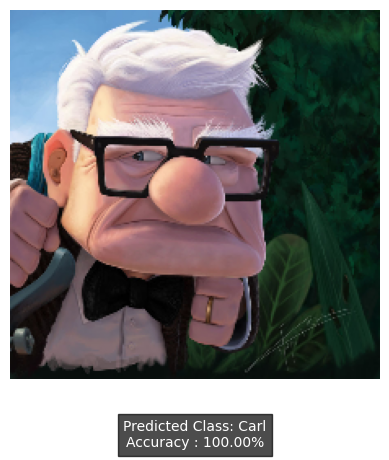

In [9]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Carl/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelAlex)

Olaf1.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 61ms/step
[[1.0680542e-03 4.7725797e-02 9.5120323e-01 2.9112505e-06]]
2


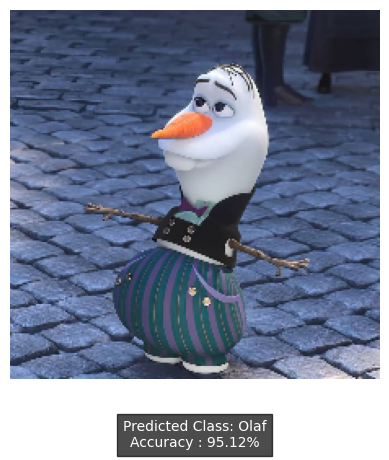

Olaf8.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 57ms/step
[[4.2892689e-01 1.2686551e-06 5.7070822e-01 3.6368682e-04]]
2


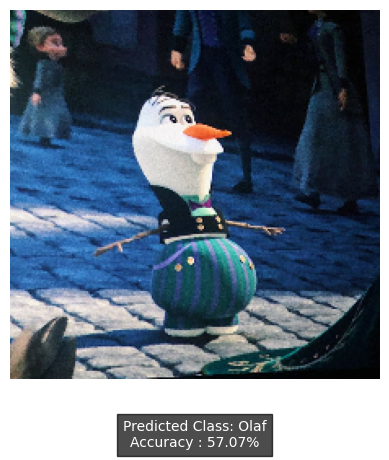

Olaf9.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 57ms/step
[[1.6294005e-05 2.3125311e-04 9.9975222e-01 2.8452118e-07]]
2


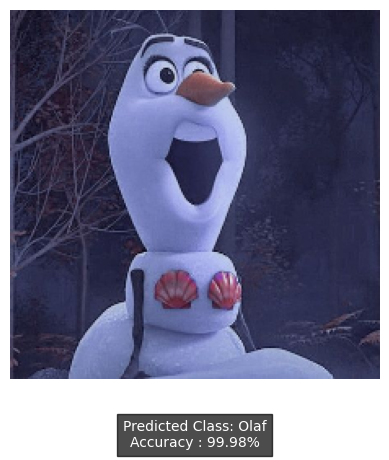

Olaf5.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 56ms/step
[[2.7254296e-07 1.5566113e-05 9.9989641e-01 8.7705273e-05]]
2


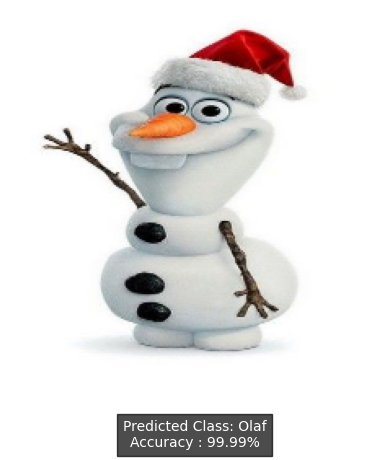

Olaf2.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 54ms/step
[[1.1779328e-05 8.5758939e-03 9.9138230e-01 3.0009598e-05]]
2


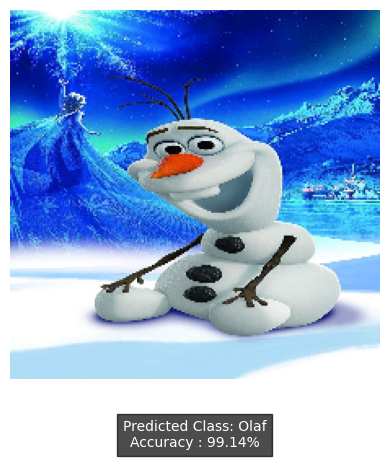

Olaf3.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 62ms/step
[[4.0845300e-09 1.0000000e+00 1.3303805e-08 2.5754730e-08]]
1


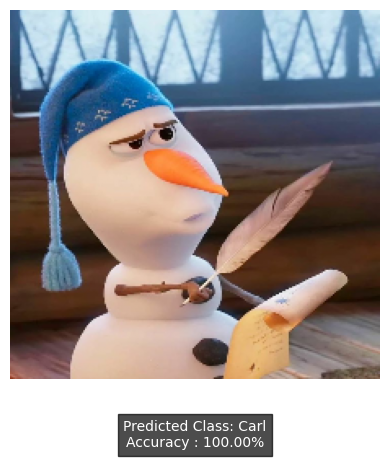

Olaf7.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[8.6036380e-03 6.6701847e-04 9.9015093e-01 5.7843316e-04]]
2


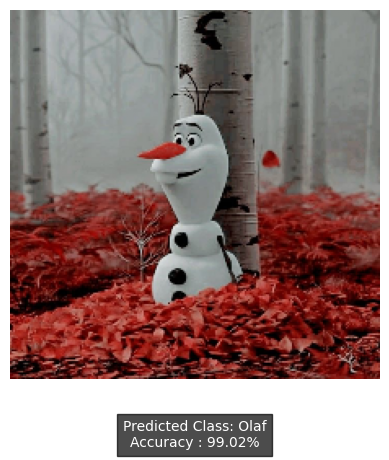

Olaf4.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[3.8909020e-05 1.9656903e-07 9.9996090e-01 4.4829123e-09]]
2


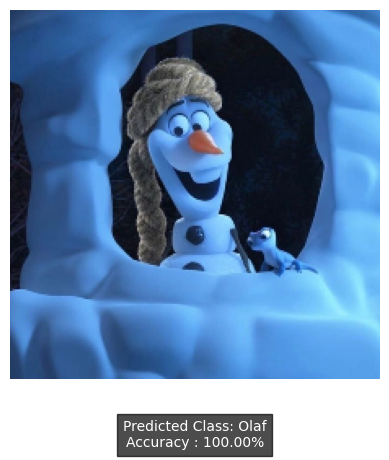

Olaf10.gif
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[2.0789570e-05 5.8590067e-05 9.9992001e-01 5.9320570e-07]]
2


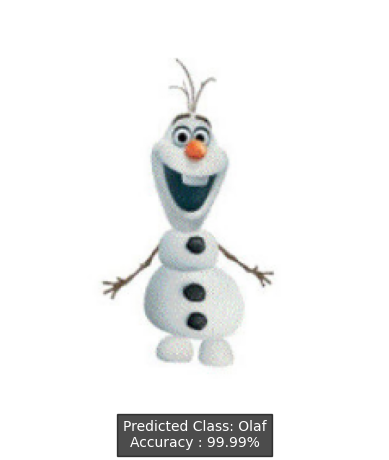

Olaf6.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[1.8674282e-04 8.2624331e-03 9.9145281e-01 9.7994205e-05]]
2


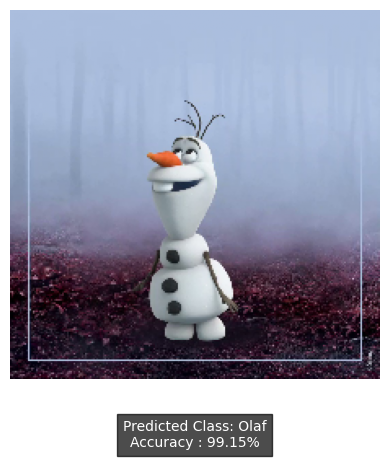

In [10]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Olaf/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelAlex)

Woody1.jpeg
(1, 227, 227, 3)
1/1 [==============================] - 0s 37ms/step
[[9.9615418e-09 9.1137481e-10 5.2367458e-08 9.9999988e-01]]
3


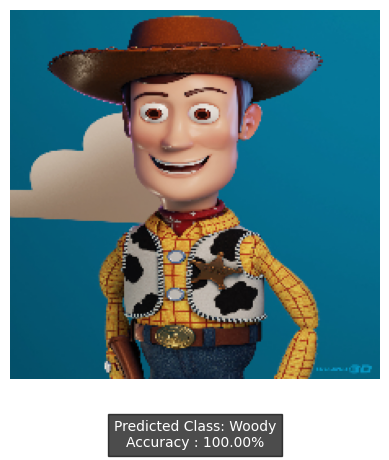

Woody3.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 35ms/step
[[9.4711379e-15 2.5802433e-11 2.2767627e-10 1.0000000e+00]]
3


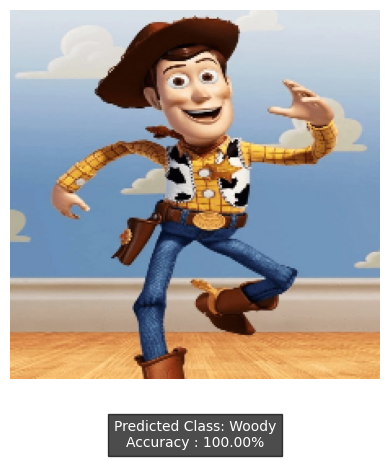

Woody2.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[5.27786653e-07 1.06034465e-02 6.00681997e-05 9.89335954e-01]]
3


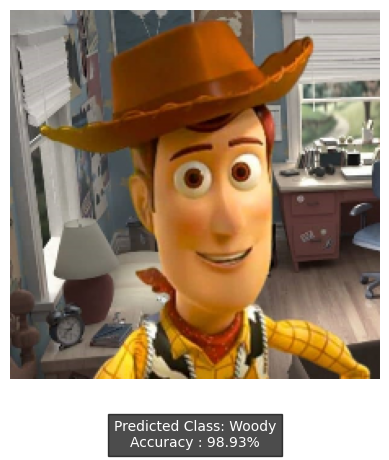

Woody4.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 34ms/step
[[7.6578301e-04 1.9678794e-02 5.8907899e-04 9.7896636e-01]]
3


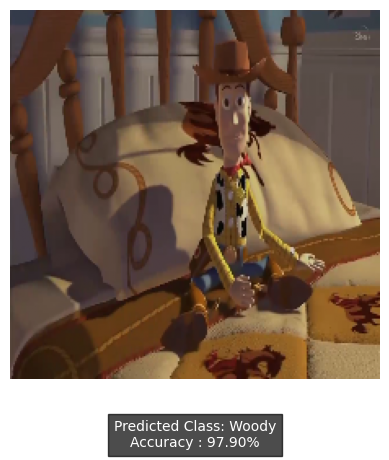

Woody5.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 34ms/step
[[5.8215554e-03 2.2216456e-03 4.9255174e-05 9.9190760e-01]]
3


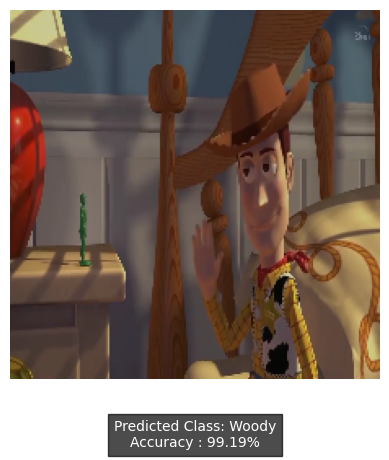

Woody6.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 36ms/step
[[0.00106689 0.04325056 0.00280513 0.95287746]]
3


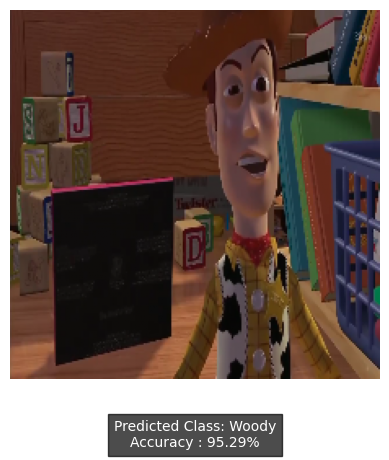

Woody7.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 45ms/step
[[2.7862113e-04 2.1863581e-05 7.6254430e-05 9.9962318e-01]]
3


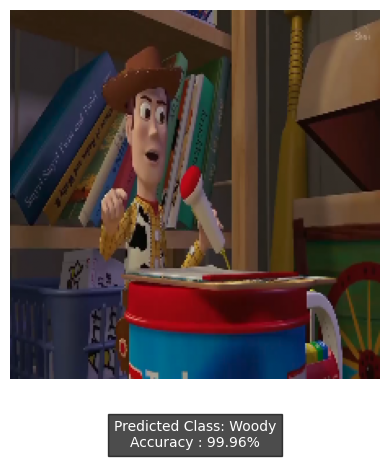

Woody8.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 53ms/step
[[7.2526839e-04 1.2253028e-05 1.0972007e-05 9.9925143e-01]]
3


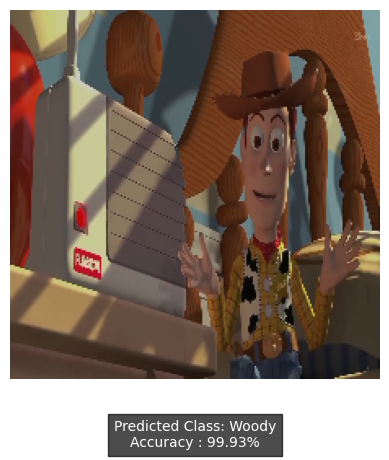

Woody9.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 57ms/step
[[9.3127172e-03 3.6978573e-03 7.0503535e-04 9.8628438e-01]]
3


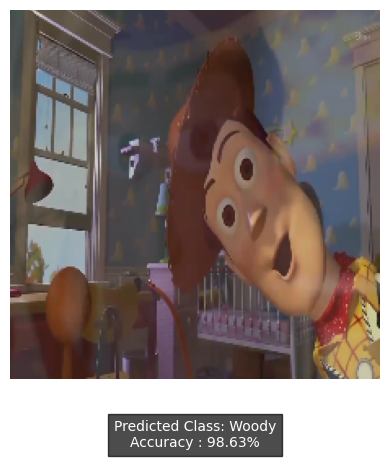

Woody10.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 51ms/step
[[0.00950536 0.00113181 0.00297467 0.98638815]]
3


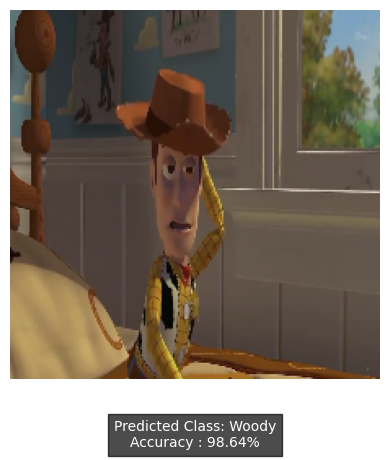

In [11]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Woody/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelAlex)

Bolt2.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 37ms/step
[[0.9788278  0.01417834 0.00436928 0.00262458]]
0


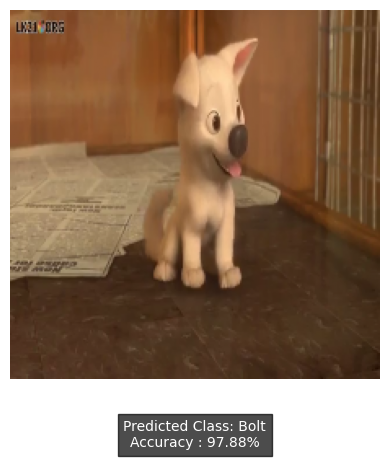

Bolt3.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[7.3388082e-01 2.6507410e-01 1.0384995e-03 6.5045115e-06]]
0


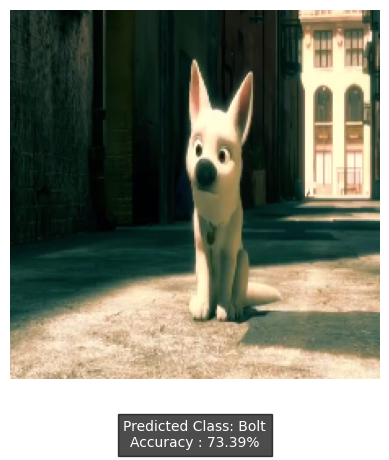

Bolt10.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 45ms/step
[[9.9987519e-01 2.7159767e-05 1.2653221e-06 9.6271004e-05]]
0


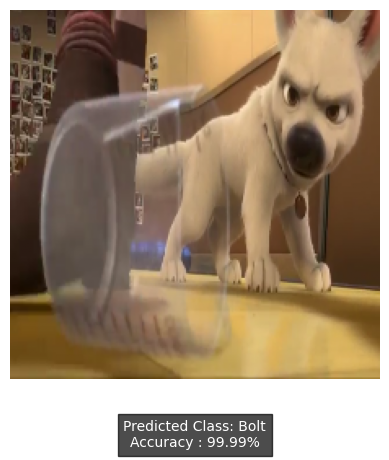

Bolt4.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 33ms/step
[[9.9954885e-01 8.9994697e-05 6.7928804e-06 3.5440037e-04]]
0


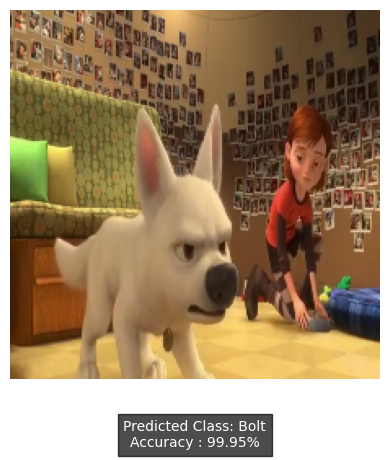

Bolt9.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 40ms/step
[[9.9706465e-01 2.2983926e-03 4.1756665e-04 2.1947315e-04]]
0


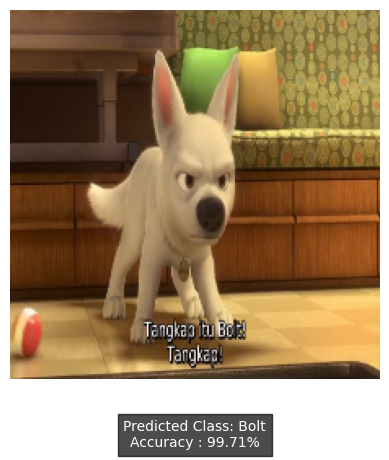

Bolt7.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 35ms/step
[[0.8407498  0.05740992 0.01890336 0.08293697]]
0


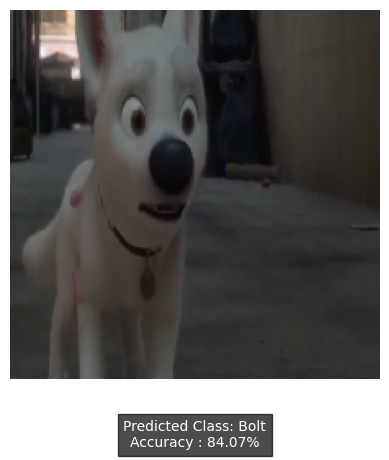

Bolt8.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 44ms/step
[[9.0433443e-01 9.5540479e-02 7.9789112e-05 4.5288376e-05]]
0


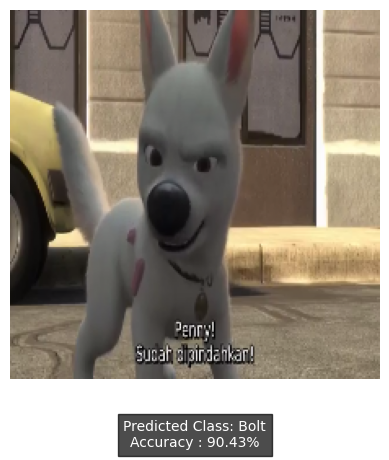

Bolt1.jpg
(1, 227, 227, 3)
1/1 [==============================] - 0s 34ms/step
[[9.1851097e-01 7.9061992e-02 2.4254145e-03 1.5987795e-06]]
0


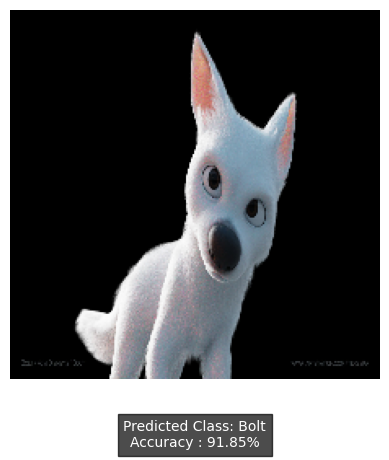

Bolt6.png
(1, 227, 227, 3)
1/1 [==============================] - 0s 31ms/step
[[0.90616006 0.00386495 0.0059636  0.08401146]]
0


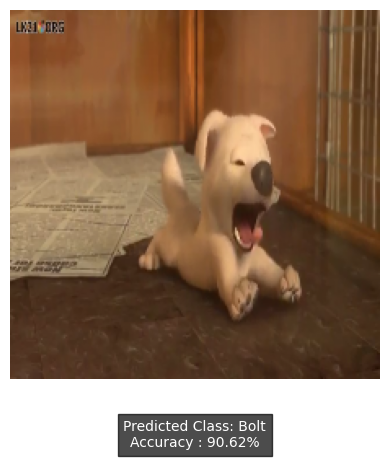

In [14]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Bolt/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelAlex)

## Prediksi Model VGGNet


In [15]:
modelVGG = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/Testing UAS/model_vgg16.h5')

In [16]:
modelVGG.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 32)      9248      
                                                                 
 batch_normalization (Batch  (None, 224, 224, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 112, 112, 32)      0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 conv2d_3 (Conv2D)           (None, 112, 112, 64)      3

In [19]:
data = tf.keras.utils.image_dataset_from_directory('/content/drive/MyDrive/Colab Notebooks/Testing UAS/Dataset')
print(data.class_names)
class_names=data.class_names

Found 679 files belonging to 4 classes.
['Bolt', 'Carl', 'Olaf', 'Woody']


In [20]:
def predict_test(img_path, model):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)

    img = cv2.resize(img, (224, 224))
    img = img / 255.0

    test_img = np.expand_dims(img, axis=0)
    print(test_img.shape)

    predictions = []

    pred = model.predict(test_img)
    print(pred)
    print(np.argmax(pred))
    accuracy = pred[0][np.argmax(pred)] * 100

    predicted_class = class_names[np.argmax(pred)]

    plt.imshow(img)
    plt.axis('off')  # Turn off axis labels

    text = "Predicted Class: {}\nAccuracy : {:.2f}%".format(predicted_class, accuracy)
    plt.text(0.5, -0.15, text, ha='center', va='center', transform=plt.gca().transAxes, color='white', fontsize=10, bbox=dict(facecolor='black', alpha=0.7))

    predictions.append((predicted_class, accuracy))
    # Show the plot
    plt.show()

    return predictions



Carl9.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 474ms/step
[[0.10282443 0.64469033 0.02054717 0.23193811]]
1


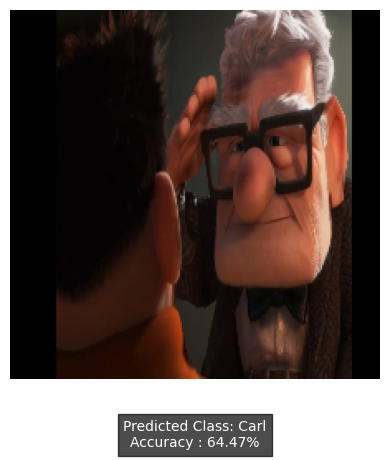

Carl6.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 483ms/step
[[0.10007715 0.88328266 0.01011206 0.00652811]]
1


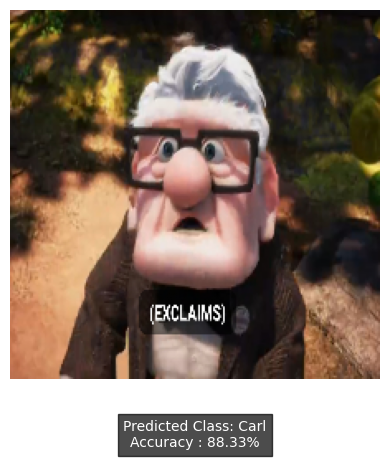

Carl8.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 321ms/step
[[0.09018173 0.7345402  0.07944535 0.09583267]]
1


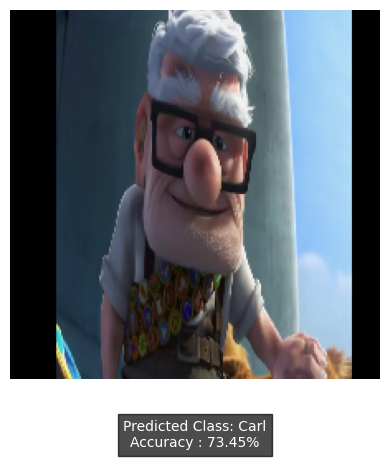

Carl7.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 176ms/step
[[3.5853533e-03 9.9616903e-01 1.4623700e-04 9.9410943e-05]]
1


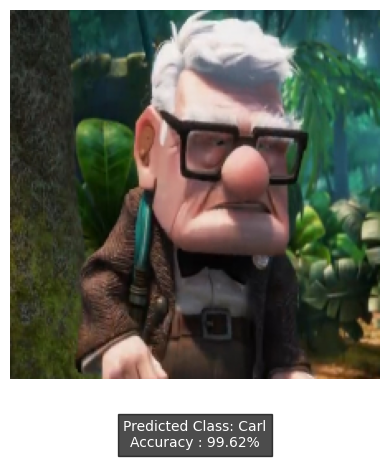

Carl2.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 179ms/step
[[0.0310961  0.94129074 0.02510729 0.00250584]]
1


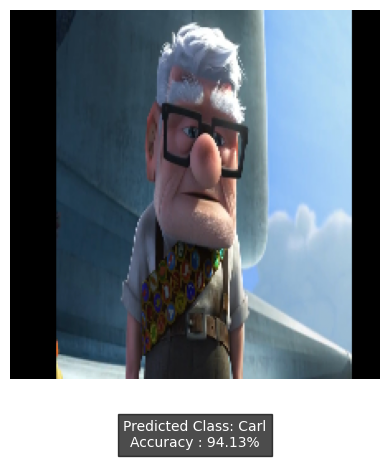

Carl3.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 195ms/step
[[0.06477115 0.9268057  0.00306606 0.00535715]]
1


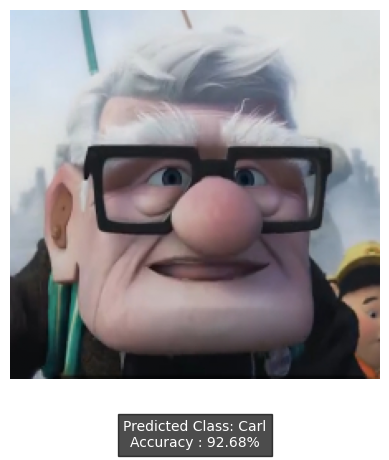

Carl4.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 186ms/step
[[0.25555712 0.09552394 0.15790695 0.49101207]]
3


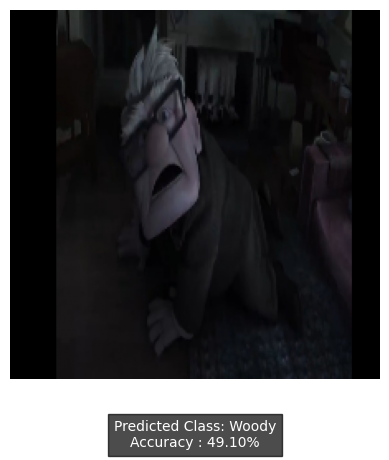

Carl5.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 195ms/step
[[0.27885607 0.1523939  0.12383376 0.44491628]]
3


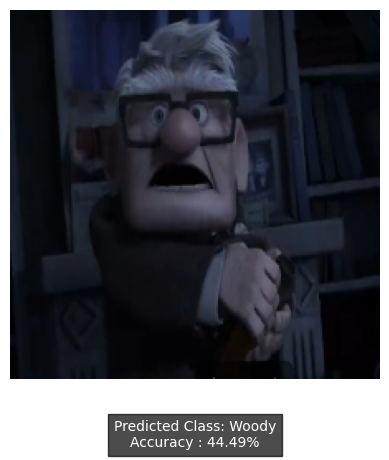

Carl10.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 195ms/step
[[2.4002607e-03 9.9749547e-01 5.4966331e-05 4.9328297e-05]]
1


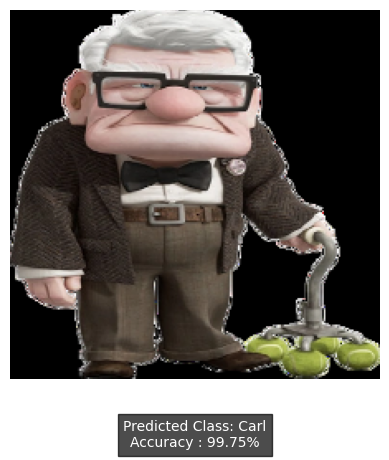

Carl1.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 192ms/step
[[0.08026217 0.9137088  0.00227334 0.0037557 ]]
1


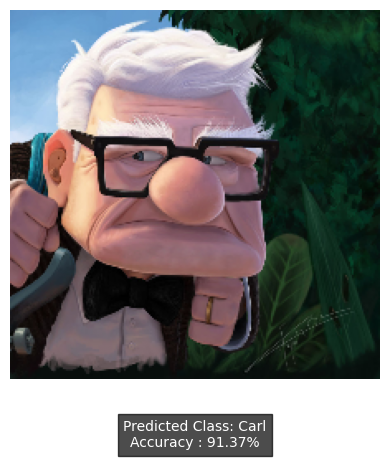

In [21]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Carl/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelVGG)

Woody1.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 168ms/step
[[4.3496687e-04 9.5808727e-04 1.2224481e-03 9.9738449e-01]]
3


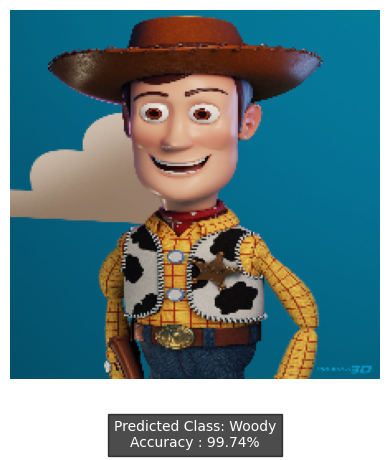

Woody3.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 188ms/step
[[0.0050824  0.00618972 0.00957461 0.9791533 ]]
3


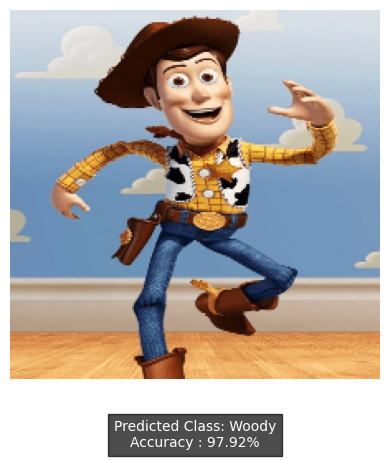

Woody2.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 177ms/step
[[0.05803839 0.02962398 0.01640307 0.8959345 ]]
3


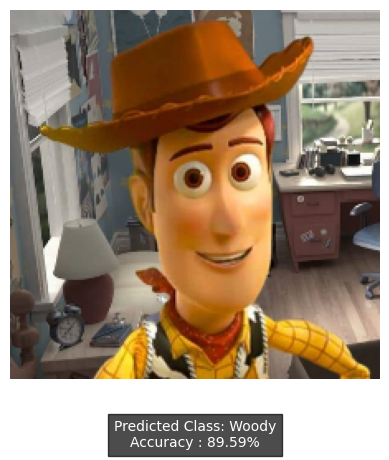

Woody4.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 273ms/step
[[0.01582211 0.10027951 0.00724133 0.87665707]]
3


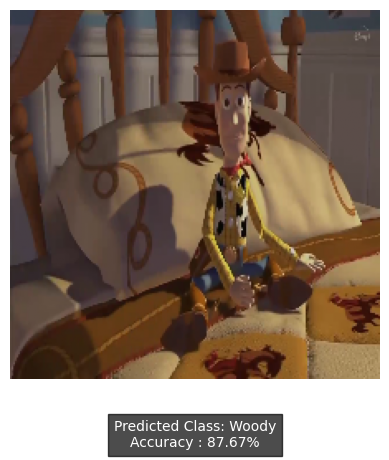

Woody5.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 186ms/step
[[0.00789998 0.01507407 0.0147282  0.96229774]]
3


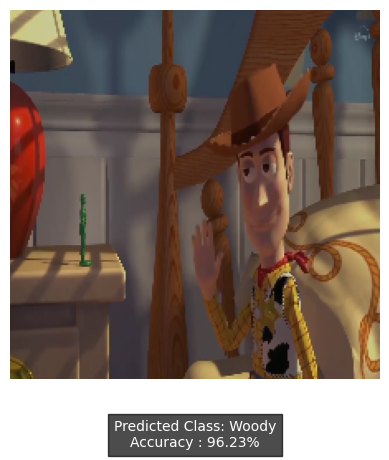

Woody6.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 180ms/step
[[0.0404716  0.08158326 0.06787181 0.8100734 ]]
3


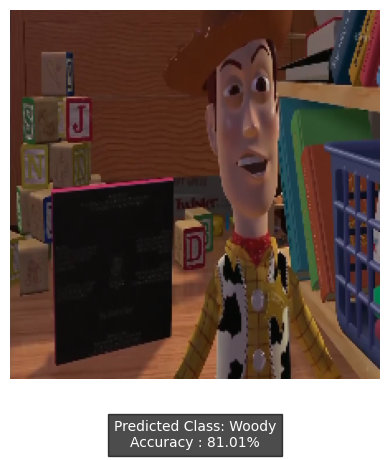

Woody7.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 219ms/step
[[0.04294319 0.01685954 0.08696512 0.85323215]]
3


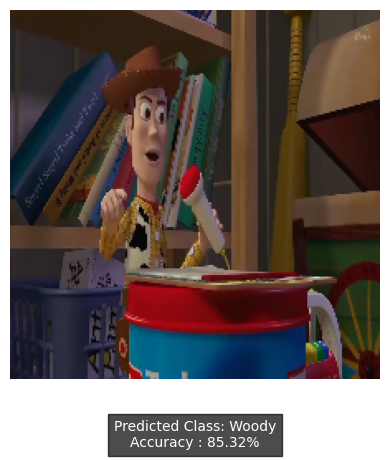

Woody8.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 259ms/step
[[0.05976226 0.02301965 0.05532119 0.8618969 ]]
3


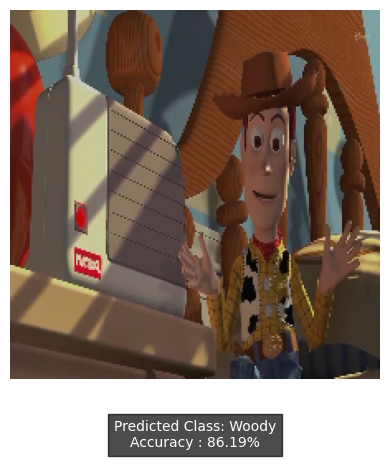

Woody9.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 291ms/step
[[0.04535459 0.03548438 0.01471423 0.9044468 ]]
3


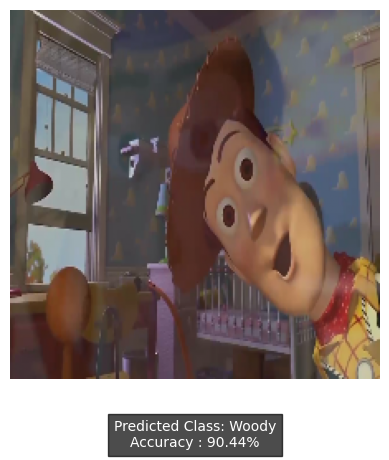

Woody10.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 319ms/step
[[0.09051208 0.06310278 0.05418442 0.79220074]]
3


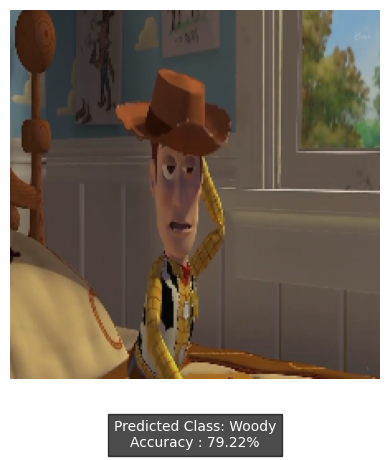

In [23]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Woody/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelVGG)

Olaf1.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 324ms/step
[[0.00342016 0.04088474 0.9487261  0.00696888]]
2


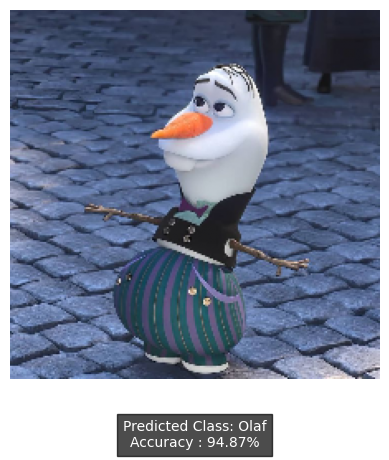

Olaf8.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 307ms/step
[[0.03519905 0.01061784 0.93499213 0.01919099]]
2


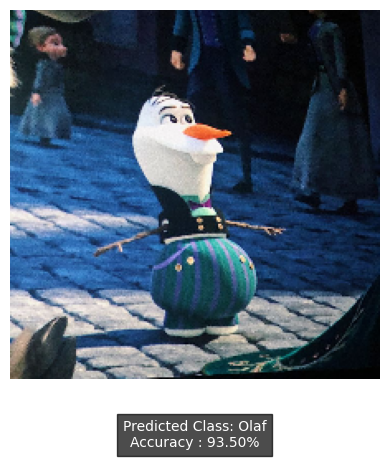

Olaf9.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 316ms/step
[[9.2227099e-04 2.5820481e-03 9.9619055e-01 3.0512101e-04]]
2


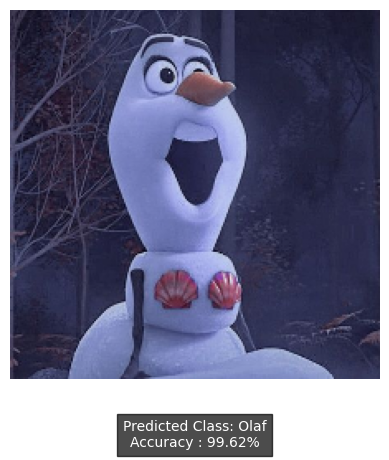

Olaf5.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 336ms/step
[[0.03117753 0.03569004 0.9230715  0.010061  ]]
2


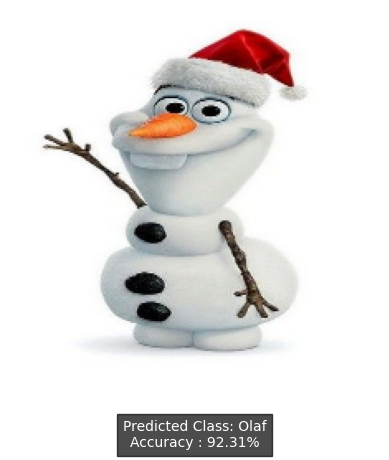

Olaf2.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 328ms/step
[[0.00509602 0.08849736 0.89333063 0.01307597]]
2


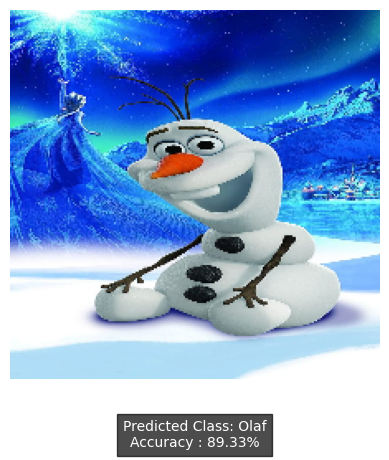

Olaf3.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 322ms/step
[[0.03879487 0.95540035 0.00278262 0.0030221 ]]
1


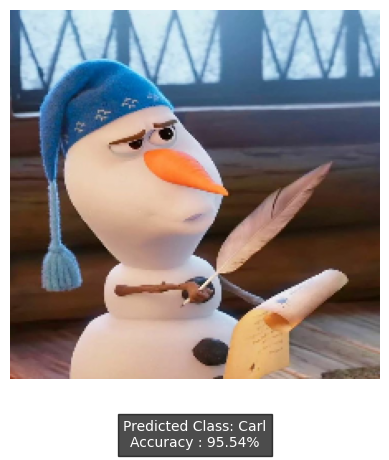

Olaf7.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 326ms/step
[[0.08512501 0.8943055  0.0123642  0.00820516]]
1


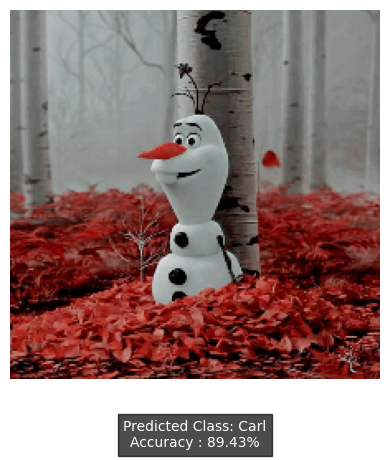

Olaf4.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 185ms/step
[[0.02066253 0.11631531 0.7636757  0.09934651]]
2


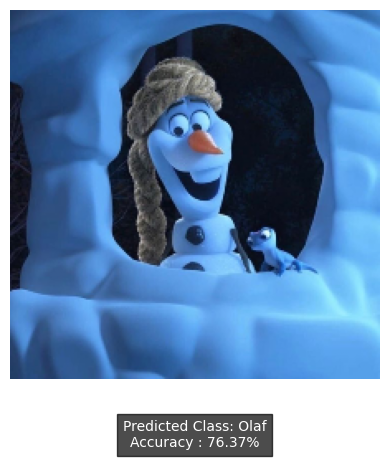

Olaf10.gif
(1, 224, 224, 3)
1/1 [==============================] - 0s 201ms/step
[[0.08915217 0.0559843  0.5964755  0.25838807]]
2


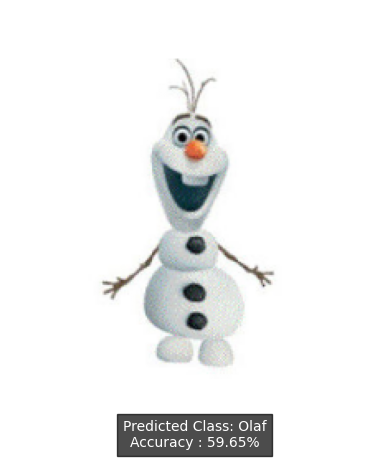

Olaf6.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 209ms/step
[[0.05837734 0.14564012 0.78752166 0.00846097]]
2


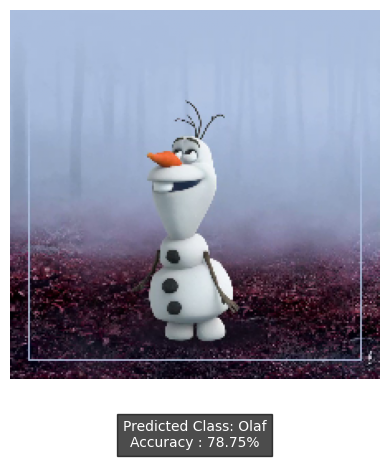

In [22]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Olaf/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelVGG)

Bolt2.png
(1, 224, 224, 3)
1/1 [==============================] - 1s 521ms/step
[[0.51115555 0.34006462 0.01672738 0.1320525 ]]
0


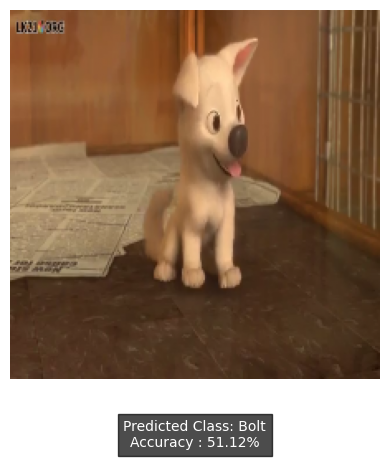

Bolt3.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 321ms/step
[[0.8955111  0.02119838 0.01784425 0.06544622]]
0


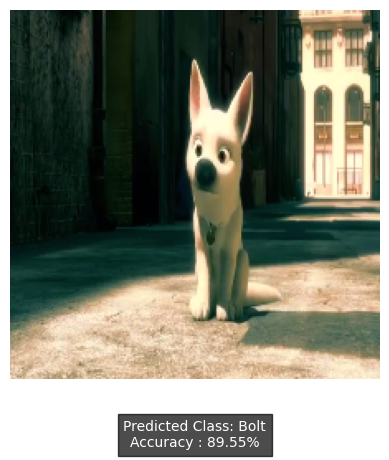

Bolt10.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 303ms/step
[[9.9854255e-01 5.5684400e-04 1.9631130e-04 7.0435158e-04]]
0


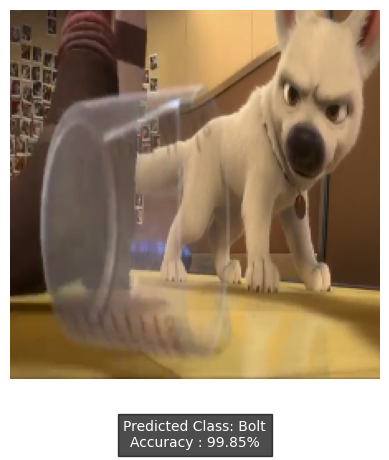

Bolt4.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 445ms/step
[[0.8394728  0.03675658 0.00842995 0.11534066]]
0


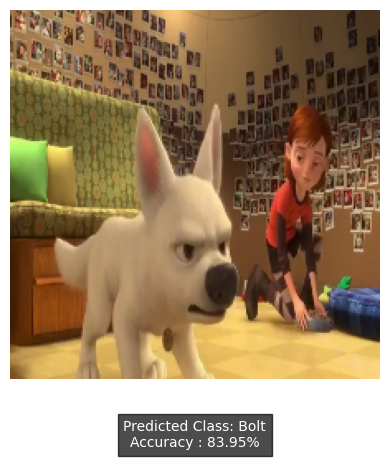

Bolt9.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 473ms/step
[[0.76074725 0.20501451 0.00993759 0.02430057]]
0


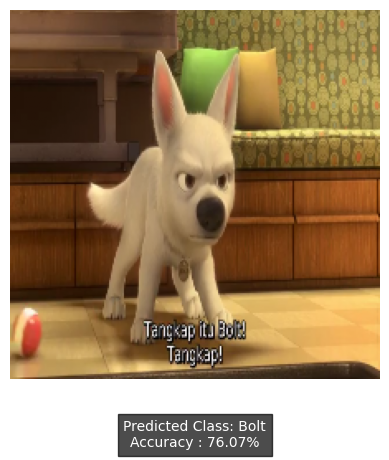

Bolt7.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 228ms/step
[[0.40319416 0.0985778  0.05713125 0.4410968 ]]
3


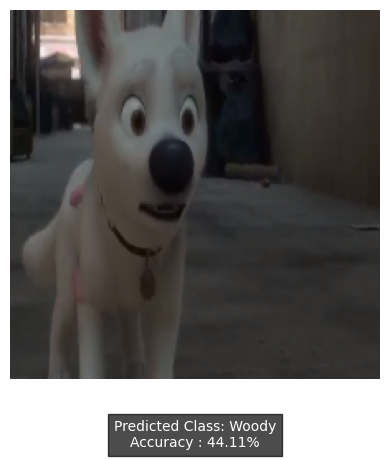

Bolt8.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 181ms/step
[[0.38876298 0.1914589  0.05551683 0.3642613 ]]
0


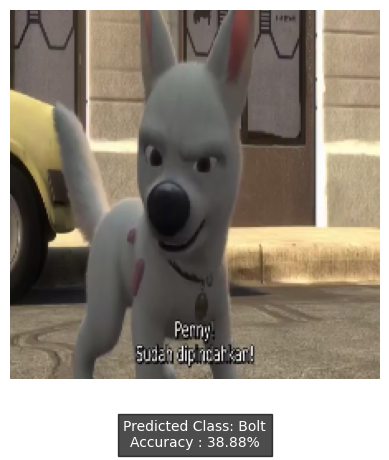

Bolt1.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 182ms/step
[[0.46278185 0.1568579  0.28703463 0.09332555]]
0


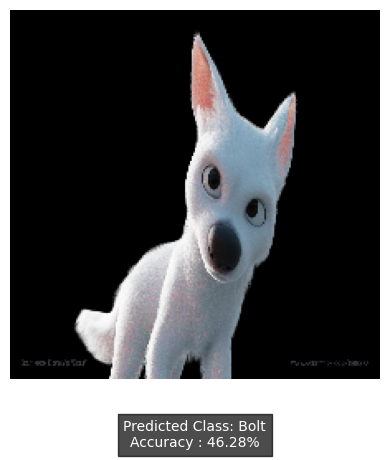

Bolt6.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 183ms/step
[[0.39275962 0.45049995 0.01203997 0.14470053]]
1


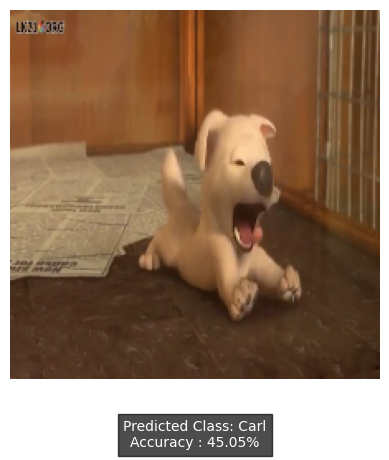

In [24]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Bolt/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelVGG)

## Prediksi Model ResNet

In [25]:
modelRes = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/Testing UAS/model_resnet.h5')

In [26]:
modelAlex.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 55, 55, 96)        34944     
                                                                 
 max_pooling2d (MaxPooling2  (None, 27, 27, 96)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 27, 27, 64)        153664    
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 13, 13, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 13, 13, 128)       73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 13, 13, 128)       1

In [27]:
data = tf.keras.utils.image_dataset_from_directory('/content/drive/MyDrive/Colab Notebooks/Testing UAS/Dataset')
print(data.class_names)
class_names=data.class_names

Found 679 files belonging to 4 classes.
['Bolt', 'Carl', 'Olaf', 'Woody']


In [40]:
def predict_test(img_path, model):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)

    img = cv2.resize(img, (224, 224))
    img = img / 255.0

    test_img = np.expand_dims(img, axis=0)
    print(test_img.shape)

    predictions = []

    pred = model.predict(test_img)
    print(pred.flatten()[:10])
    print(np.argmax(pred))
    accuracy = pred[0][np.argmax(pred)] * 100

    predicted_class = class_names[np.argmax(pred)]

    plt.imshow(img)
    plt.axis('off')  # Turn off axis labels

    text = "Predicted Class: {}\nAccuracy : {:.2f}%".format(predicted_class, accuracy)
    plt.text(0.5, -0.15, text, ha='center', va='center', transform=plt.gca().transAxes, color='white', fontsize=10, bbox=dict(facecolor='black', alpha=0.7))

    predictions.append((predicted_class, accuracy))
    # Show the plot
    plt.show()

    return predictions



Carl9.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 108ms/step
[1.5426758e-02 9.3323171e-01 1.2893903e-03 4.9567722e-02 2.1378563e-07
 4.2359076e-07 3.3704612e-07 3.4743616e-07 2.0477924e-07 8.1594220e-07]
1


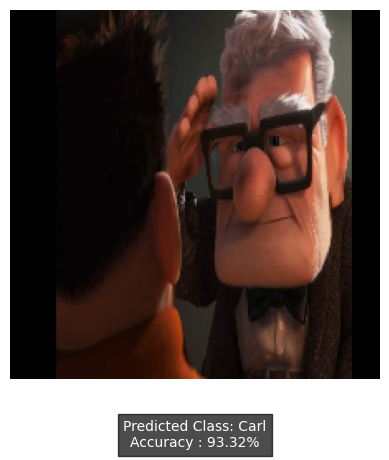

Carl6.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 106ms/step
[2.6108409e-04 9.9965537e-01 7.9687685e-05 6.5902066e-07 6.7755579e-10
 3.9049293e-09 1.7133263e-09 1.5341352e-09 1.0385885e-09 4.1849288e-09]
1


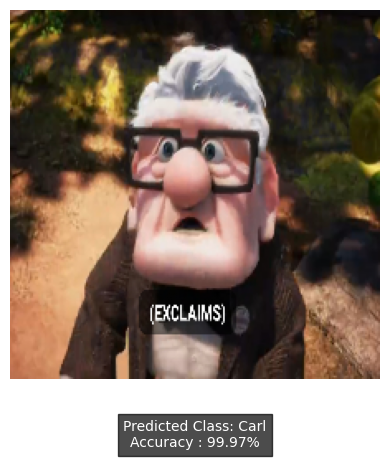

Carl8.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 112ms/step
[9.7194237e-01 2.4454175e-02 2.8357626e-05 3.5400430e-03 1.0531151e-08
 7.9310396e-08 2.4869450e-08 1.3663329e-08 9.0645607e-09 4.9545015e-08]
0


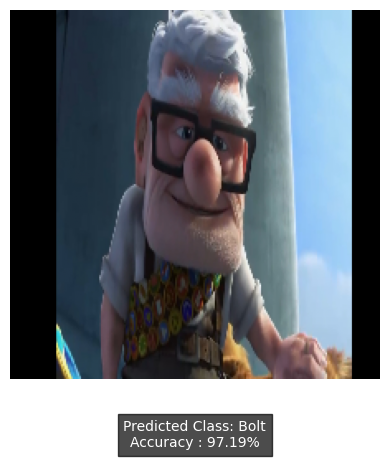

Carl7.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 113ms/step
[2.1336090e-03 9.9786335e-01 9.9681608e-07 1.1579490e-06 1.5905999e-10
 2.1020732e-09 4.5929155e-10 3.5354955e-10 1.7558312e-10 1.1110877e-09]
1


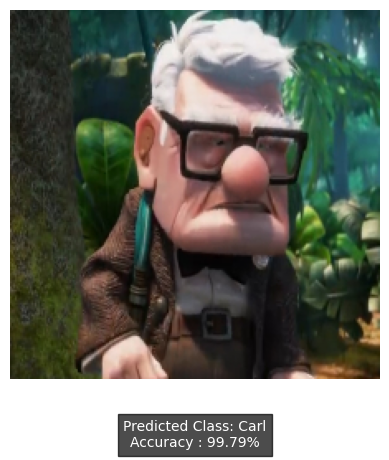

Carl2.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 132ms/step
[7.9346162e-01 2.0395939e-01 2.0725764e-03 3.5144831e-04 4.5672746e-08
 2.8826011e-07 9.3985044e-08 6.6516989e-08 6.8460331e-08 1.8243087e-07]
0


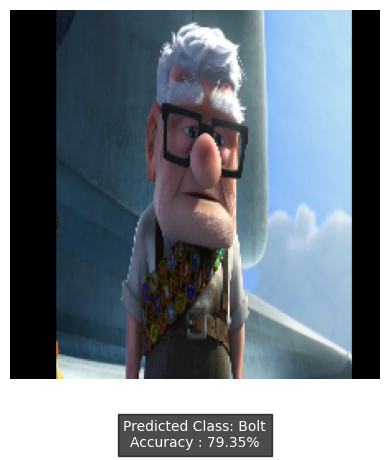

Carl3.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 113ms/step
[9.88602757e-01 1.13858245e-02 1.53628605e-07 1.05230529e-05
 8.72138264e-11 1.56397562e-09 2.25566593e-10 1.20174204e-10
 6.03806102e-11 7.21147031e-10]
0


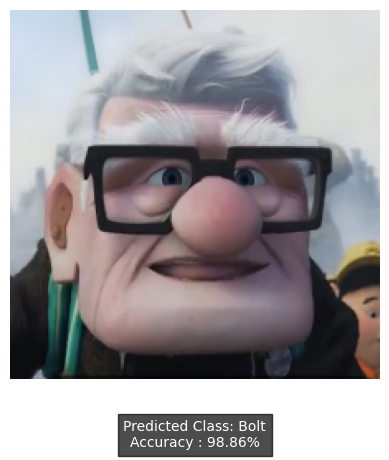

Carl4.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 128ms/step
[3.0425286e-01 7.4372113e-02 8.8823885e-02 5.2791339e-01 3.5455896e-06
 5.2307000e-06 5.4458151e-06 2.6325376e-06 2.8188515e-06 8.6218124e-06]
3


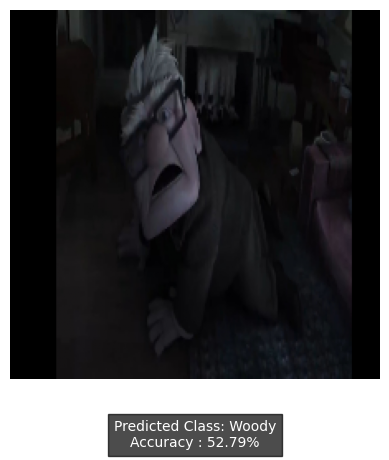

Carl5.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 114ms/step
[2.7524531e-01 2.7050540e-01 4.5109200e-01 1.2136814e-03 1.2492007e-06
 2.2680110e-06 1.9325171e-06 1.0971319e-06 1.6028662e-06 2.5119682e-06]
2


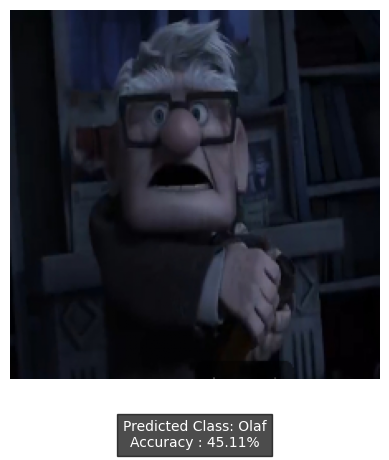

Carl10.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 125ms/step
[6.9778896e-04 9.9928492e-01 1.6090522e-05 1.9962359e-07 1.8408162e-10
 1.2839362e-09 5.3170474e-10 4.5536053e-10 2.3067263e-10 1.7077298e-09]
1


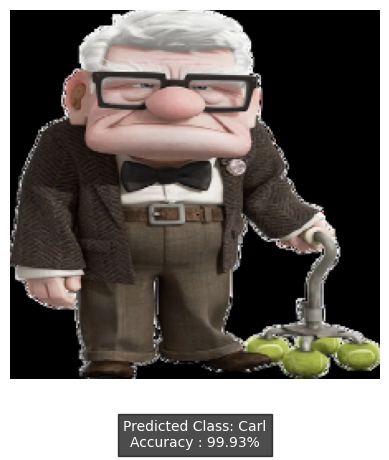

Carl1.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 113ms/step
[1.4032157e-05 9.9998581e-01 1.6656497e-07 2.0080018e-09 1.8560329e-12
 2.9487180e-11 6.0297067e-12 4.7009050e-12 2.6333397e-12 1.7971839e-11]
1


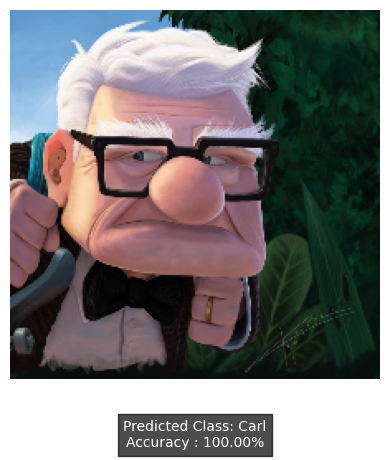

In [41]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Carl/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelRes)

Olaf1.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 107ms/step
[8.6596119e-04 2.4109527e-04 9.9887723e-01 5.4941438e-06 7.8830116e-09
 6.1088317e-09 4.4499995e-09 4.8779807e-09 1.8577099e-08 6.4233316e-09]
2


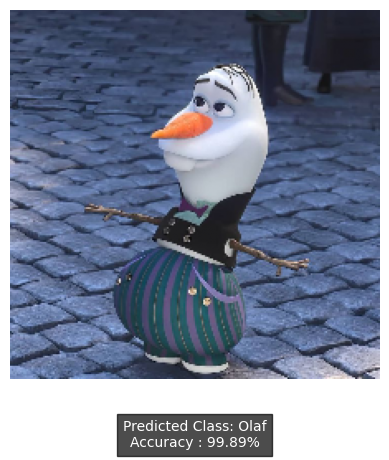

Olaf8.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 114ms/step
[4.1299887e-02 7.4037822e-04 9.5795304e-01 5.5711200e-07 2.0974187e-09
 4.4480339e-09 3.2645027e-09 1.9734494e-09 5.2964664e-09 4.6602016e-09]
2


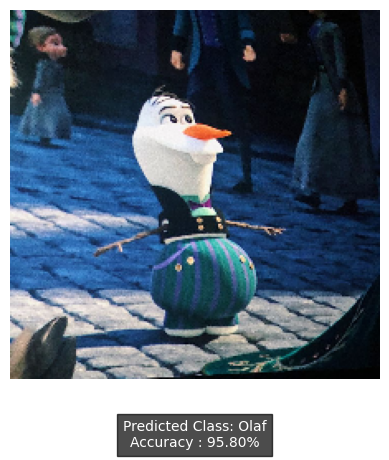

Olaf9.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 113ms/step
[2.5325394e-04 4.7844267e-04 9.9925882e-01 2.0668820e-06 5.9166179e-09
 3.5959005e-09 4.2546771e-09 4.1243009e-09 1.1261806e-08 6.3803047e-09]
2


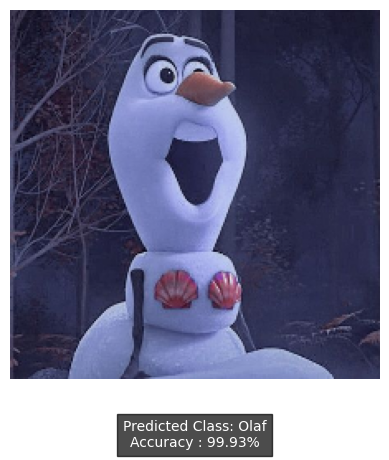

Olaf5.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 112ms/step
[1.04694344e-01 2.44038878e-03 8.51439118e-01 4.07708585e-02
 3.89461547e-07 4.70038458e-07 3.33684653e-07 2.24852570e-07
 7.14483861e-07 8.97645918e-07]
2


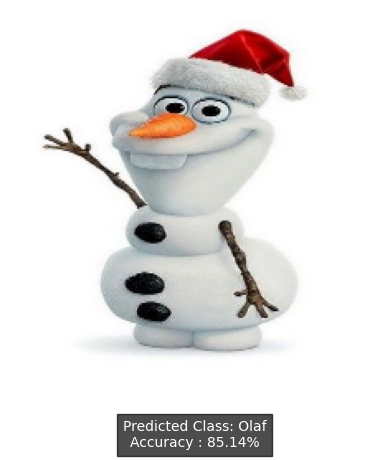

Olaf2.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 118ms/step
[8.0840415e-05 1.5544608e-04 9.9976081e-01 7.9457260e-07 1.4875200e-09
 1.0464095e-09 5.3496563e-10 8.5243357e-10 5.2523847e-09 1.2278955e-09]
2


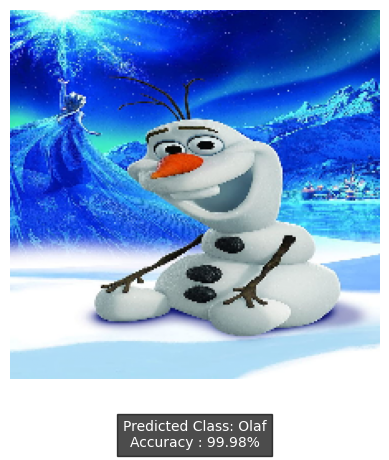

Olaf3.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 207ms/step
[9.8576480e-01 1.4208502e-02 2.3084118e-05 7.9034561e-07 4.8593779e-10
 4.3228470e-09 1.1957975e-09 6.8225769e-10 4.3077331e-10 2.6334164e-09]
0


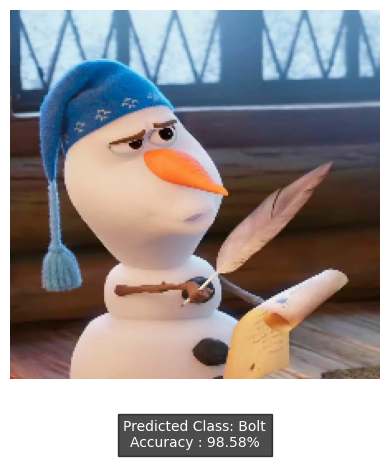

Olaf7.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 241ms/step
[9.9590993e-01 3.9427578e-03 1.4179052e-04 1.7700114e-06 8.3267848e-10
 4.4744106e-09 1.5811470e-09 1.6140000e-09 7.4589296e-10 5.3779123e-09]
0


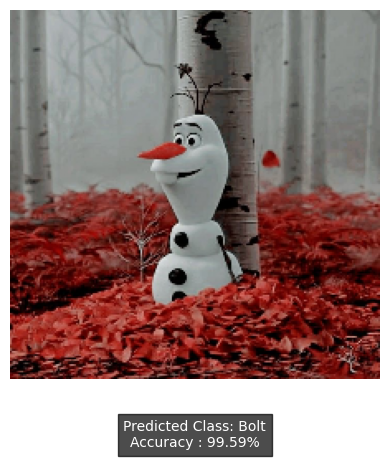

Olaf4.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 231ms/step
[1.3285540e-03 2.6076287e-04 9.9839598e-01 5.1167640e-06 5.3555476e-09
 6.0634702e-09 4.3438182e-09 3.7634873e-09 1.6793301e-08 8.6290148e-09]
2


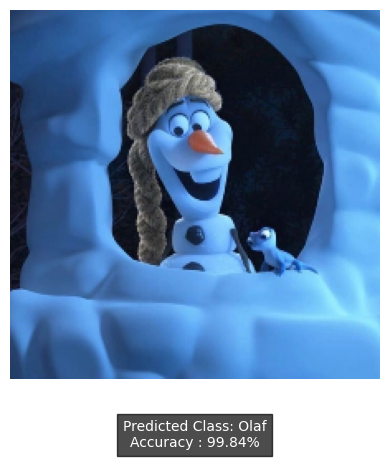

Olaf10.gif
(1, 224, 224, 3)
1/1 [==============================] - 0s 174ms/step
[2.4599005e-02 1.1619637e-03 9.7415876e-01 3.8953731e-05 1.9770264e-08
 3.8985558e-08 1.6775349e-08 1.3253091e-08 8.1735358e-08 3.3418765e-08]
2


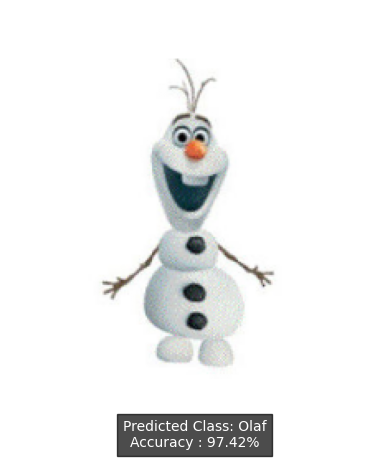

Olaf6.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 182ms/step
[5.3231660e-02 5.0745033e-02 8.9592773e-01 1.0116348e-05 3.4017525e-08
 8.8931870e-08 3.6403851e-08 3.5703071e-08 9.5265946e-08 8.3637353e-08]
2


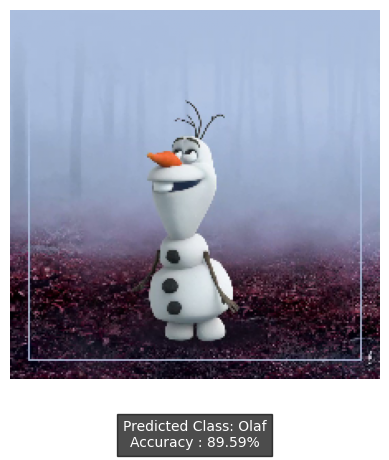

In [42]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Olaf/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelRes)

Woody1.jpeg
(1, 224, 224, 3)
1/1 [==============================] - 0s 175ms/step
[3.2063946e-04 1.2852749e-03 1.1342997e-05 9.9836904e-01 5.8109513e-09
 8.0345526e-09 7.5624618e-09 6.3552723e-09 4.3129735e-09 2.5973129e-08]
3


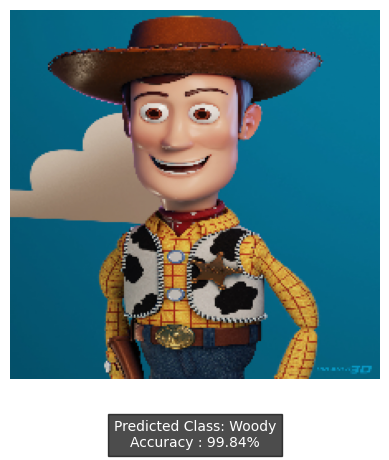

Woody3.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 175ms/step
[6.44072564e-03 6.79493928e-03 1.29333523e-04 9.86483634e-01
 7.43371302e-08 1.16017596e-07 9.60534479e-08 6.03175039e-08
 5.14582474e-08 3.25834009e-07]
3


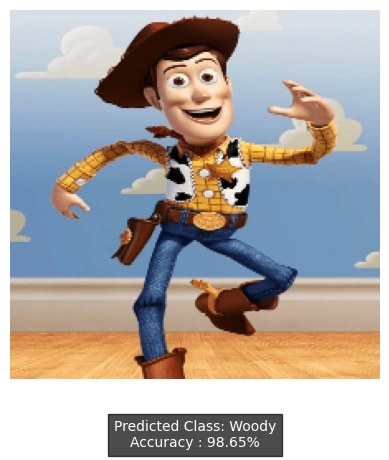

Woody2.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 196ms/step
[9.6757734e-01 1.4660248e-02 1.0652845e-04 1.7484624e-02 7.7460037e-08
 1.8615752e-07 1.1529257e-07 7.2236375e-08 3.6214121e-08 3.2770993e-07]
0


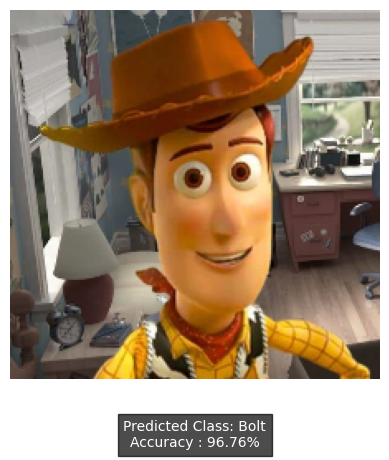

Woody4.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 173ms/step
[5.5765271e-02 1.1615239e-02 6.3229389e-05 9.3243307e-01 5.2401329e-08
 1.2691920e-07 1.0981019e-07 6.0726002e-08 4.2232731e-08 2.6104195e-07]
3


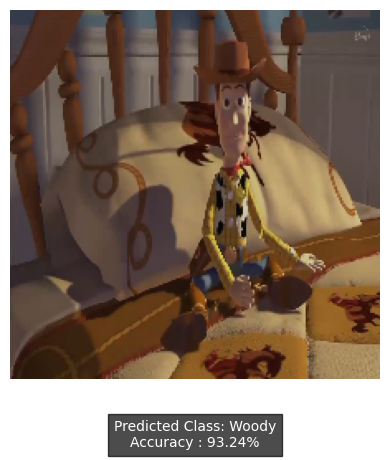

Woody5.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 132ms/step
[1.04606271e-01 3.61322099e-03 9.49592621e-04 8.90563726e-01
 1.36578990e-07 2.14009177e-07 2.64889280e-07 1.16813737e-07
 1.13570785e-07 6.62139541e-07]
3


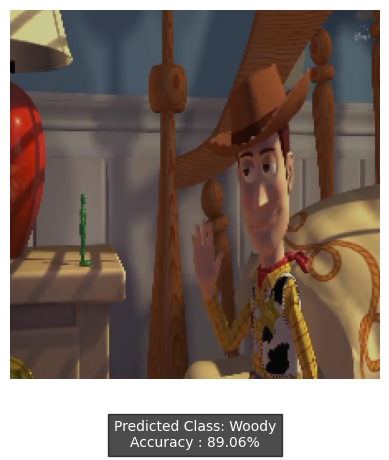

Woody6.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 113ms/step
[1.2043414e-02 3.4704220e-03 8.3638605e-04 9.8337770e-01 1.8825469e-07
 1.3894210e-07 2.4632266e-07 2.1230048e-07 1.2255762e-07 7.0735047e-07]
3


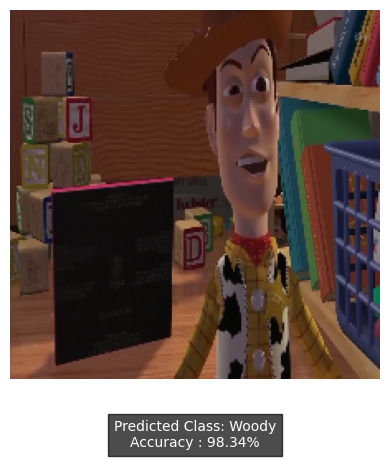

Woody7.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 117ms/step
[2.2267621e-02 1.3157928e-02 2.3383875e-03 9.6170539e-01 3.1107660e-07
 3.1661000e-07 4.4574540e-07 3.4448547e-07 2.1450114e-07 1.2456754e-06]
3


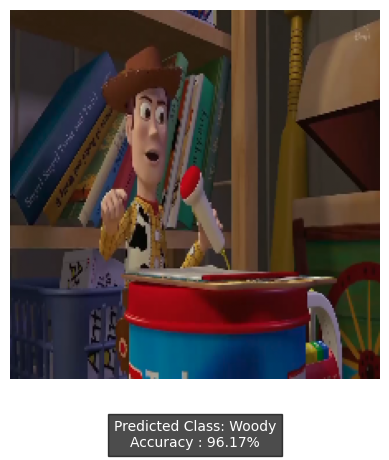

Woody8.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 126ms/step
[2.8547391e-02 1.6963701e-03 1.8362410e-04 9.6939528e-01 1.1854808e-07
 1.0566150e-07 1.3996141e-07 1.3243169e-07 6.6070228e-08 3.7947615e-07]
3


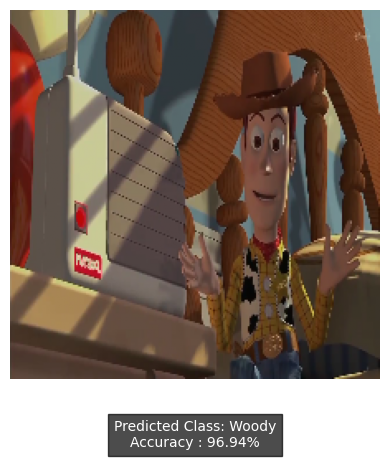

Woody9.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 139ms/step
[5.7498837e-01 2.1625555e-01 3.7190143e-04 2.0769888e-01 2.7831837e-07
 9.9918316e-07 5.7112391e-07 2.6514476e-07 2.3605325e-07 1.0617662e-06]
0


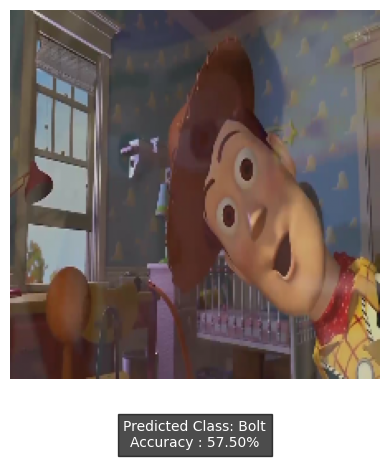

Woody10.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 122ms/step
[1.9079905e-02 1.0732354e-03 2.7026265e-04 9.7947466e-01 4.8956259e-08
 9.2422972e-08 1.2544317e-07 3.2293805e-08 4.5766569e-08 2.3637934e-07]
3


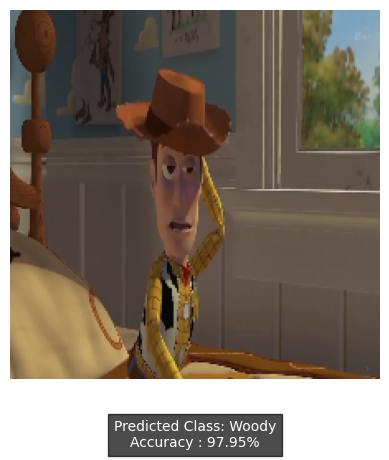

In [43]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Woody/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelRes)

Bolt2.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 107ms/step
[9.9989164e-01 8.0328682e-05 6.3092563e-07 2.6590627e-05 2.3976607e-10
 1.4858488e-09 5.1156779e-10 1.5711174e-10 8.4069869e-11 1.1556539e-09]
0


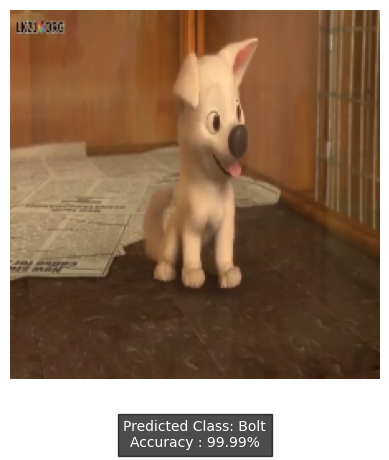

Bolt3.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 113ms/step
[9.9991202e-01 5.0216244e-05 1.9218567e-05 1.7271583e-05 3.6512834e-10
 2.2036570e-09 1.1338154e-09 2.6826968e-10 2.6251598e-10 1.7239852e-09]
0


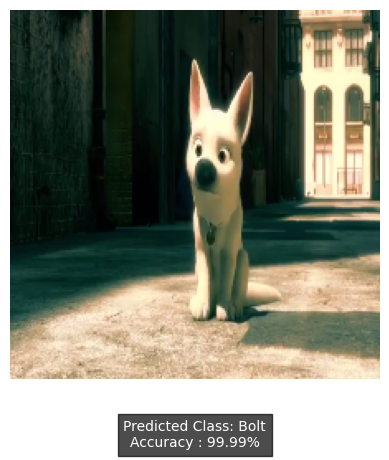

Bolt10.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 113ms/step
[9.9942929e-01 1.2873326e-04 1.0451153e-05 4.2758204e-04 1.2170952e-09
 7.9480014e-09 3.6850416e-09 1.0480335e-09 9.0044394e-10 6.1679768e-09]
0


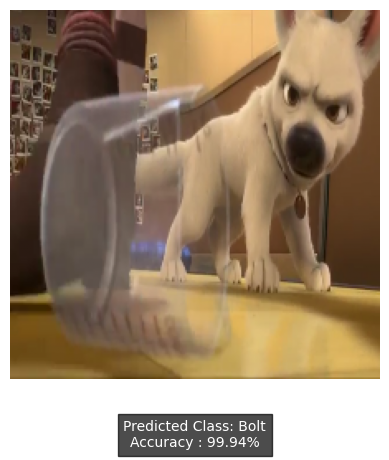

Bolt4.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 107ms/step
[9.9878436e-01 7.2988379e-04 5.5265622e-07 4.8101292e-04 1.4896940e-09
 7.1681123e-09 2.4469771e-09 1.2824318e-09 6.1707456e-10 6.5772530e-09]
0


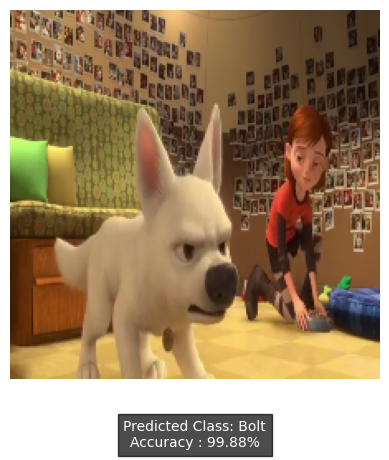

Bolt9.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 112ms/step
[9.9821979e-01 1.6515059e-03 2.0455287e-05 9.9877390e-05 2.6781579e-09
 1.6596116e-08 6.8679094e-09 3.3907435e-09 2.1667008e-09 1.1745222e-08]
0


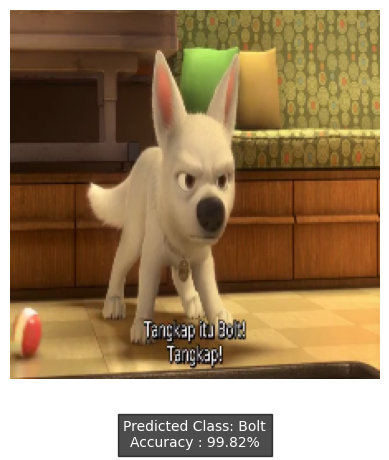

Bolt7.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 115ms/step
[9.8566967e-01 1.0106587e-02 1.2572543e-04 4.0618451e-03 1.3641717e-08
 7.3849321e-08 3.6031398e-08 1.1175278e-08 9.7621164e-09 6.1440005e-08]
0


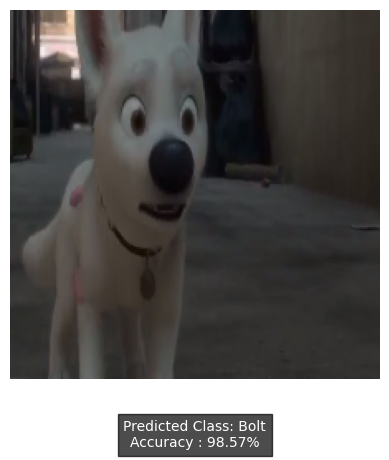

Bolt8.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 118ms/step
[9.9982291e-01 1.4285134e-04 8.0073096e-06 2.4961791e-05 3.3521033e-10
 3.4167920e-09 1.1753313e-09 3.1443287e-10 3.6114248e-10 1.5420146e-09]
0


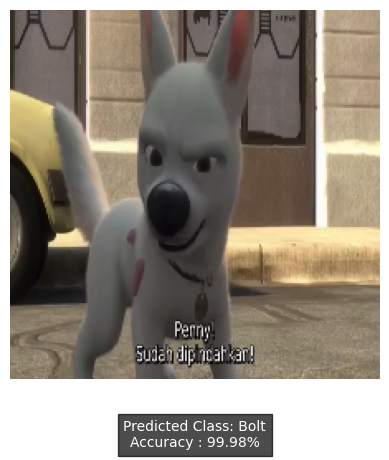

Bolt1.jpg
(1, 224, 224, 3)
1/1 [==============================] - 0s 116ms/step
[9.6639210e-01 7.5081312e-03 2.6006294e-02 2.6000143e-05 2.6070245e-08
 7.4932700e-08 5.0003315e-08 2.4196540e-08 2.5629813e-08 8.2158820e-08]
0


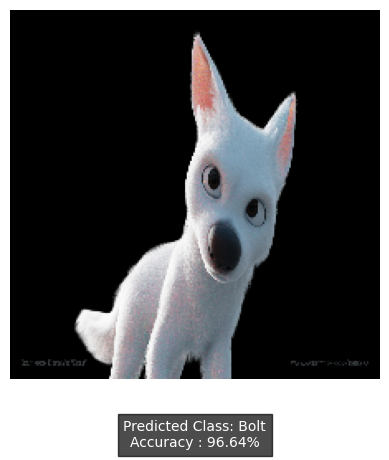

Bolt6.png
(1, 224, 224, 3)
1/1 [==============================] - 0s 120ms/step
[9.9892837e-01 4.5005800e-04 3.5156336e-06 6.0944783e-04 3.3403340e-09
 1.4578546e-08 6.0666916e-09 2.0766218e-09 1.2666707e-09 1.3335583e-08]
0


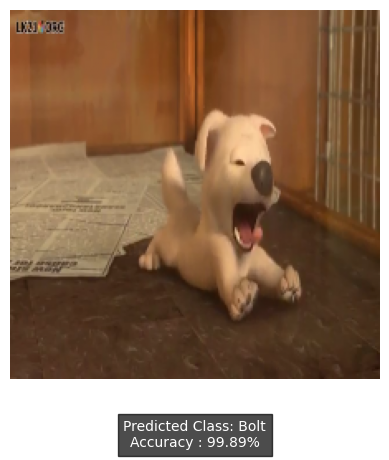

In [44]:
import os as os

data_dir = '/content/drive/MyDrive/Colab Notebooks/Test/Bolt/'

for image in os.listdir(data_dir):
    print(image)
    predict_test(data_dir + image, modelRes)